In [ ]:
import numpy as np
import cv2
from pathlib import Path
from scipy.spatial import cKDTree
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

from descriptor_index_pb2 import DescriptorIndex
from debug_fusion_pb2 import DebugFusion
from utils import plot_imgs
%load_ext autoreload
%autoreload 2

INDEX_ROOT = '../deep-relocalization/data/'
MAP_ROOT = '../deep-relocalization/maps/'

In [120]:
def get_index(name):
    index = DescriptorIndex()
    with open(Path(INDEX_ROOT, name).as_posix(), 'rb') as f:
        index.ParseFromString(f.read())
    return index
def get_debug_data(name):
    debug = DebugFusion()
    with open(Path(INDEX_ROOT, name).as_posix(), 'rb') as f:
        debug.ParseFromString(f.read())
    return debug
def get_data_from_index(index):
    positions = np.stack([f.position_vector.data for f in index.frames])
    rotations = np.stack([np.reshape(f.rotation_matrix.data, (3, 3), order='C') for f in index.frames])
    descriptors = np.stack([f.global_descriptor.data for f in index.frames])
    resources = np.stack([f.resource_name for f in index.frames])
    ids = [f.vertex_id for f in index.frames]
    return {'pos': positions, 'rot': rotations, 'descriptors': descriptors, 'res': resources, 'ids': ids}
def get_image(index, i):
    Path(MAP_ROOT, index.data_name, 'resources/raw_images/')
    return cv2.imread(
        Path(MAP_ROOT, index.data_name, 'resources/raw_images/', '%s.pgm' % index.frames[i].resource_name).as_posix())

In [94]:
ref_file = 'lindenhof_afternoon_aligned_model-nopca.pb'
query_file = 'lindenhof_wet_aligned_model-nopca.pb'

In [95]:
ref_index = get_index(ref_file)
query_index = get_index(query_file)
ref_data = get_data_from_index(ref_index)
query_data = get_data_from_index(query_index)

In [121]:
debug_data = get_debug_data('fusion_debug.pb')
ok_queries = [q for q in debug_data.query_components if q.status == 'ok']
fail_queries = [q for q in debug_data.query_components if q.status == 'fail']

# Distribution of the size of the clusters containing ground truth matches

- Blue: successful queries
- Orange: failed queries

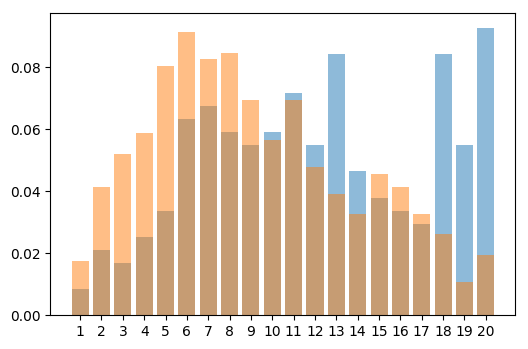

In [101]:
len_ok = [len(q.retrieved_ids) for q in ok_queries]
len_fail = [len(q.retrieved_ids) for q in fail_queries]
plt.figure(dpi=100)
plt.bar(*(lambda i, c: (i, c/np.sum(c)))(*np.unique(len_ok, return_counts=True)), alpha=0.5);
plt.bar(*(lambda i, c: (i, c/np.sum(c)))(*np.unique(len_fail, return_counts=True)), alpha=0.5);
plt.xticks(list(set(np.unique(len_ok)) or set(np.unique(len_fail))));

# Sucessful queries

- First column: query image
- Subsequent columns: some of the retrieved images in the same cluster
- Numbers on the left: size of the cluster

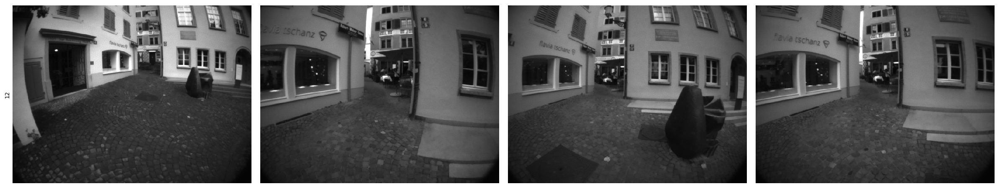

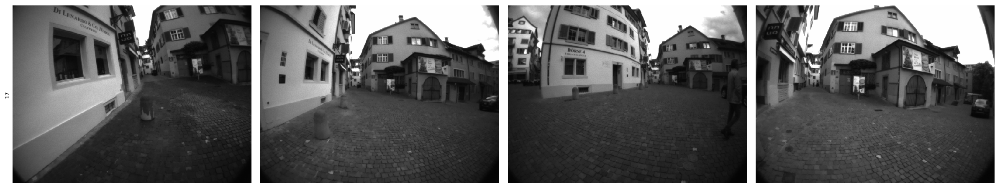

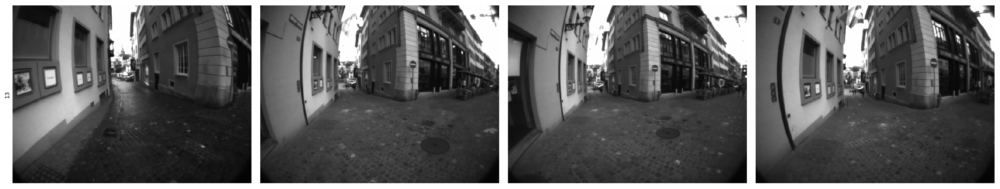

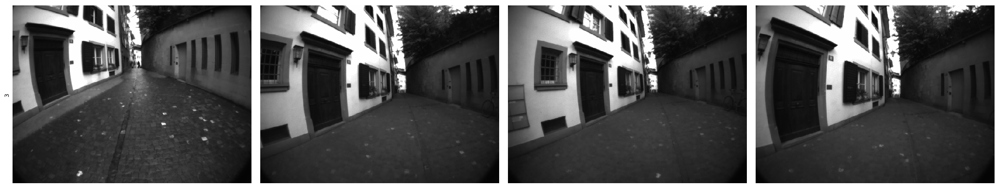

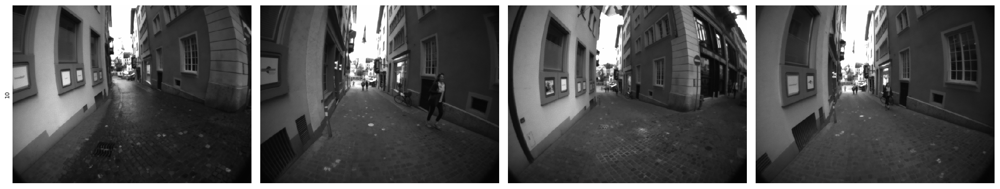

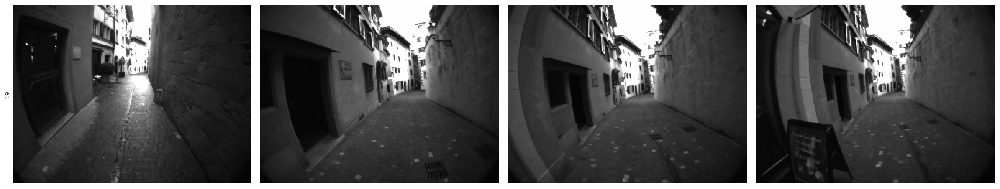

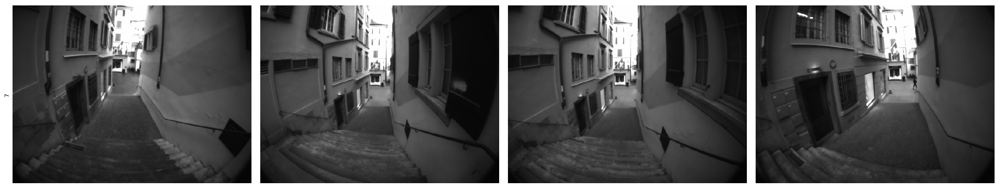

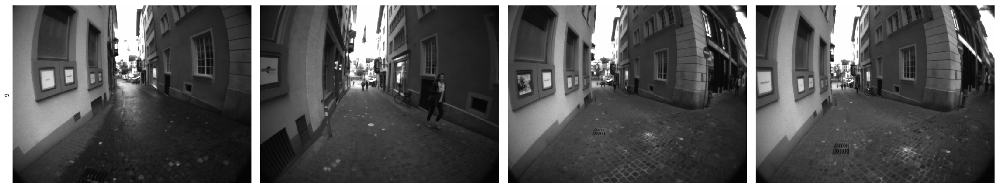

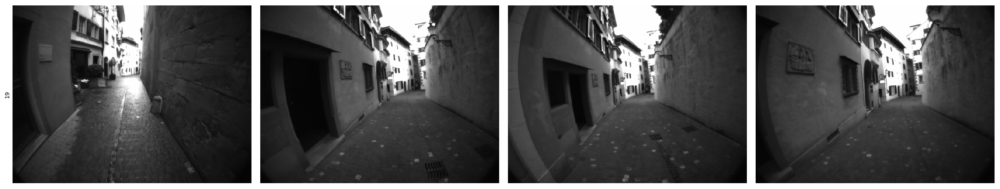

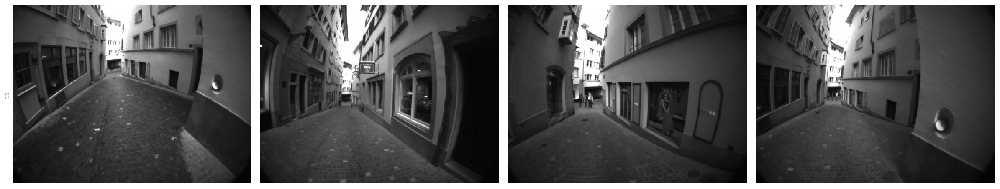

In [117]:
for i, q in zip(range(10), ok_queries):
    query_im = get_image(query_index, query_data['ids'].index(q.query_id))
    retrieved_indices = [ref_data['ids'].index(vertex_id) for vertex_id in q.retrieved_ids]
    retrieved_imgs = [get_image(ref_index, r) for r in retrieved_indices]
    plot_imgs([query_im] + retrieved_imgs[:3], ylabel=str(len(q.retrieved_ids)))

# Failed queries

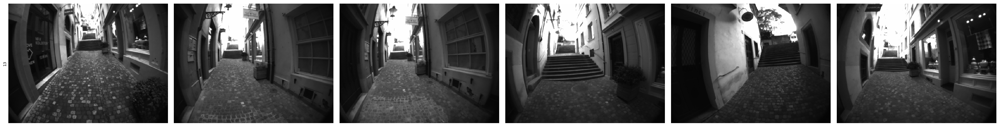

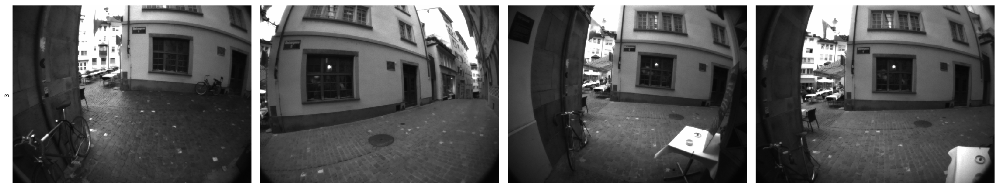

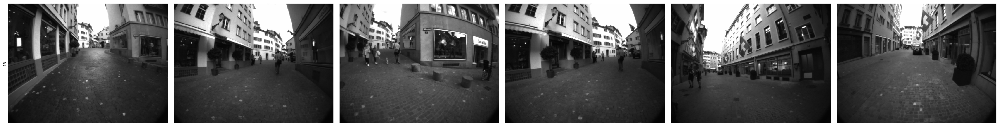

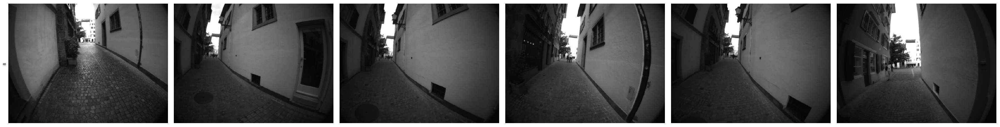

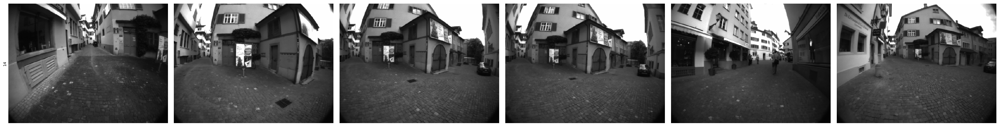

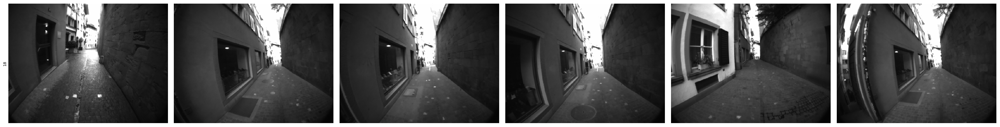

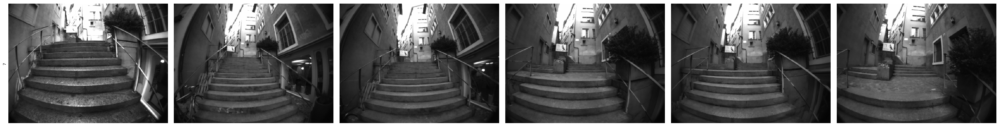

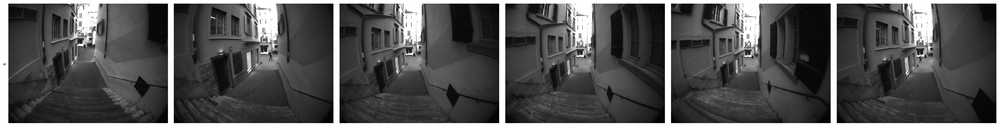

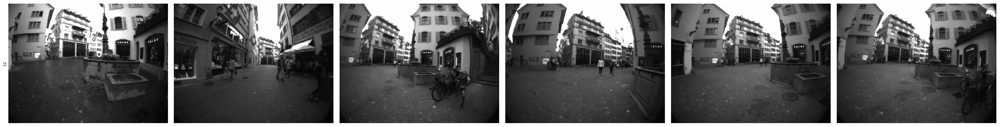

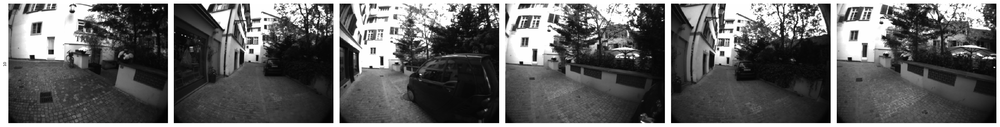

In [119]:
for i, q in zip(range(10), fail_queries):
    query_im = get_image(query_index, query_data['ids'].index(q.query_id))
    retrieved_indices = [ref_data['ids'].index(vertex_id) for vertex_id in q.retrieved_ids]
    retrieved_imgs = [get_image(ref_index, r) for r in retrieved_indices]
    plot_imgs([query_im] + retrieved_imgs[:5], ylabel=str(len(q.retrieved_ids)))